# Full Simulation Notebook

In [1]:
using CSV, DataFrames, Dates, LinearAlgebra, Distributions, DelimitedFiles, SharedArrays, Plots
gr()

import Base.Threads.@spawn
# Custom package
using Jevo

Threads.nthreads()

┌ Info: Precompiling Jevo [49da04e1-bf5b-45dd-833b-50344a2c673a]
└ @ Base loading.jl:1317


4

In [118]:
# Get date to append to output file
date = Dates.format(Dates.today(), "yyyy_mm_dd")

# Define Parameters
l0 = 10
ϵ0 = 0.7
n = 4
N = 100
fl = 1/2N
f0 = 400/2N
κ_arr = [0, 0.2, 0.5, 1, 2, 5, 10, 20]#, 20, 45] 
F = Jevo.fermi_fitness(epsilon=ϵ0, f0=f0, fl=fl, l0=l0)
emat = ϵ0* (ones(n, n) - Matrix{Float64}(I, n, n))

4×4 Matrix{Float64}:
 0.0  0.7  0.7  0.7
 0.7  0.0  0.7  0.7
 0.7  0.7  0.0  0.7
 0.7  0.7  0.7  0.0

In [119]:
function make_histogram(data)
    x = unique(data)
    y = [sum([d == t for d in data]) for t in x]
    return x, y/sum(y)
end


function Run(N, l, emat, F, κ, l0, steps)
    E_arr = zeros(Float64, steps)
    L_arr = zeros(Float64, steps)
    pop = Jevo.mono_pop(N=N, l=l)
    Jevo.initiate!(pop, emat)
    for r in 1:steps
        Jevo.bp_substitution!(pop, emat, F)
        if rand() < κ/N
            Jevo.driver_mutation!(pop)
        end
        if rand() < 1/10
            Jevo.l_substitution!(pop, emat, F)
        end
        E_arr[r] = Jevo.get_energy(pop, emat)
        L_arr[r] = length(pop.seqs)
        #if E_arr[r]/(L_arr[r]*ϵ0) > (Jevo.γ_0(n))
            #Jevo.initiate!(pop, emat)
        #end 
    end
    return E_arr, L_arr
end

Run (generic function with 2 methods)

In [120]:
E, L = Run(N, 30, emat, F, 5, l0, 10^6)
plot(E)
plot!(L)

In [121]:
# Predefine output arrays
k_list = Array{Array{Float64, 1}, 1}()
l_list = Array{Array{Float64, 1}, 1}()
Q_list = Array{Array{Float64, 1}, 1}()
κ_list = Array{Array{Float64, 1}, 1}()

for i in 1:length(κ_arr)
    push!(l_list, Float64[])
    push!(k_list, Float64[])
    push!(Q_list, Float64[])
    push!(κ_list, Float64[])
end

# uses all availabe cores
Threads.@threads for i in 1:length(κ_arr)
    E, L = Run(N, 40, emat, F, κ_arr[i], l0, 10^7)
    pairs, hist = make_histogram([(x, y) for (x, y) in zip(E[5*10^5:10^6], L[5*10^5:10^6])])
    k_list[i] = [pair[1] for pair in pairs]
    l_list[i] = [pair[2] for pair in pairs]
    Q_list[i] = hist
    κ_list[i] = ones(length(pairs)) .* κ_arr[i]
    println("Run κ = $(κ_arr[i]) done.")
end

Run κ = 0.0 done.
Run κ = 0.5 done.
Run κ = 2.0 done.
Run κ = 10.0 done.
Run κ = 0.2 done.
Run κ = 1.0 done.
Run κ = 5.0 done.
Run κ = 20.0 done.


In [122]:
df = DataFrame(Q=[(Q_list...)...], k=[(k_list...)...], l=[(l_list...)...], kappa=[(κ_list...)...])

CSV.write(date * "_results_2.csv", df)
    
#=
open(date*"_METADATA.txt", "a") do io
    write(io, "gap=$gap\n")
    write(io, "l_0=$l_0\n")
    write(io, "f0=$f0\n")
    write(io, "fl=$fl\n")
    write(io, "kappa=$κ_arr\n")
    write(io, "n=$n\n")
    write(io, "N=$N\n")
end
=#

"2021_06_16_results_2.csv"

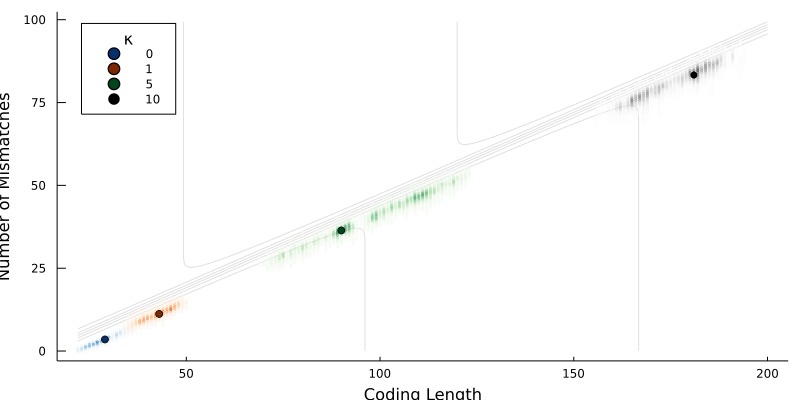

In [160]:
p = scatter(size=(800, 400), legend=:topleft, grid=false, legendtitle="κ", xlabel="Coding Length", ylabel="Number of Mismatches")

X = minimum(df.l):200
Y = minimum(df.k):0.7:100
Z = zeros(length(Y), length(X))

for i in 1:length(X)
    for j in 1:length(Y)
        Z[j, i] = Jevo.fitness(Y[j], Int(X[i]), F)
    end
end
contour!(p, X, Y, Z, color="gray", linecolor="#e0e0e0", levels=7)

for (κ, c1, c2) in zip([0, 1, 5, 10], [:Blues_9, :Oranges_9, :Greens_9, :Greys_9], ["blue", "orange", "green", "black"])
    test_df = df[df.kappa .== κ, :]
    scatter!(
        p, 
        test_df.l, 
        test_df.k, 
        marker_z=test_df.Q, 
        markersize=2, 
        markerstrokewidth=0, 
        label=:none, 
        markercolor=c1, 
        colorbar=:false, 
        colorbar_entry=false,
        markeralpha=0.5
    )
    x = test_df.l[argmax(test_df.Q)]
    y = test_df.k[argmax(test_df.Q)]
    scatter!(p, [x],[y], label=κ, color=palette(c1)[end])
end
p

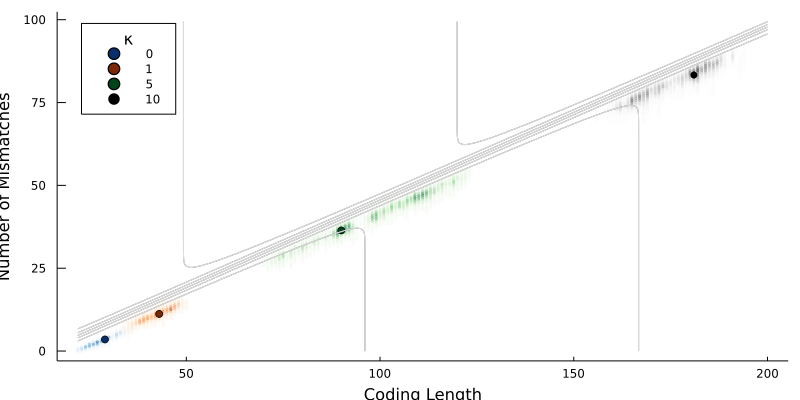

In [159]:
X = minimum(df.l):200
Y = minimum(df.k):0.7:100
Z = zeros(length(Y), length(X))

for i in 1:length(X)
    for j in 1:length(Y)
        Z[j, i] = Jevo.fitness(Y[j], Int(X[i]), F)
    end
end
contour!(p, X, Y, Z, color="gray", linecolor="#e0e0e0", levels=7)